<a href="https://colab.research.google.com/github/ashwanirajan/Nbody-Simulations/blob/main/N_bodySimulations.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter  
%matplotlib notebook
%matplotlib inline

In [4]:
cd drive/MyDrive/NbodySim/

/content/drive/MyDrive/NbodySim


In [5]:
def acceleration( pos, mass, G, delta ):

	# positions r = [x,y,z] for all particles
	x = pos[:,0:1]
	y = pos[:,1:2]
	z = pos[:,2:3]

	# calculate (x_j - x_i), (y_j - y_i), (z_j - z_i) for all possible pairs
	dx = x.T - x
	dy = y.T - y
	dz = z.T - z

	# matrix that stores 1/r^3 for all particle pairwise particle separations 
	inv_r3 = (dx**2 + dy**2 + dz**2 + delta**2)
	inv_r3 = inv_r3**(-1.5)

	ax = G * (dx * inv_r3) @ mass
	ay = G * (dy * inv_r3) @ mass
	az = G * (dz * inv_r3) @ mass
	
	# pack together the acceleration components
	a = np.hstack((ax,ay,az))

	return a

In [6]:
def Energy( pos, vel, mass, G ):

	# Kinetic Energy:
	KE = 0.5 * np.sum(np.sum( mass * velocity**2 ))


	# Potential Energy:

	# positions r = [x,y,z] for all particles
	x = pos[:,0:1]
	y = pos[:,1:2]
	z = pos[:,2:3]

	# matrix that stores all pairwise particle separations: r_j - r_i
	dx = x.T - x
	dy = y.T - y
	dz = z.T - z

	# matrix that stores 1/r for all particle pairwise particle separations 
	inv_r = np.sqrt(dx**2 + dy**2 + dz**2)
	inv_r= 1.0/inv_r

	# sum over upper triangle, to count each interaction only once
	PE = G * np.sum(np.sum(np.triu(-(mass*mass.T)*inv_r,1)))
	
	return KE, PE;

In [10]:
## Simulation

N = 100 # no of particles
D = 3 # dimensions

t         = 0      # current time of the simulation
tEnd      = 5.0   # time at which simulation ends
dt        = 0.01   # timestep
delta = 0.1    # softening length
G         = 1.0   
lower = -3
upper = 3
np.random.seed(1123)            # set the random number generator seed
zoom = 4
## Simulation initial phase

position = np.random.uniform(low=lower, high=upper, size=(N,D))
velocity = np.random.randn(N , D)

mass = np.random.uniform(low=0.5, high=12.5, size=(N,1))

#mass[4] = 8.3
# Convert to Center-of-Mass frame
#velocity -= np.mean(mass * velocity,0) / np.mean(mass)
	
# calculate initial gravitational accelerations

acc = acceleration( position, mass, G, delta )

KE, PE  = Energy( position, velocity, mass, G )

# number of timesteps
Nt = int(np.ceil(tEnd/dt))

# save position and energies
save_position = np.zeros((N, D, Nt+1))
save_position[:,:,0] = position
save_KineticE = np.zeros(Nt+1)
save_KineticE[0] = KE
save_PotentialE = np.zeros(Nt+1)
save_PotentialE[0] = PE
t_all = np.arange(Nt+1)*dt


# prep figure





/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in true_divide


In [8]:
print(mass.T.shape)

(1, 100)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in true_divide


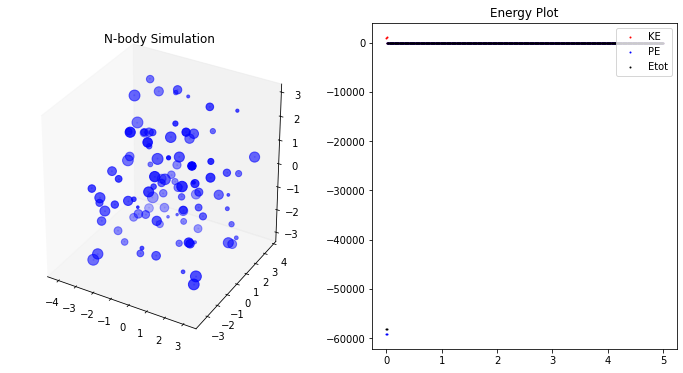

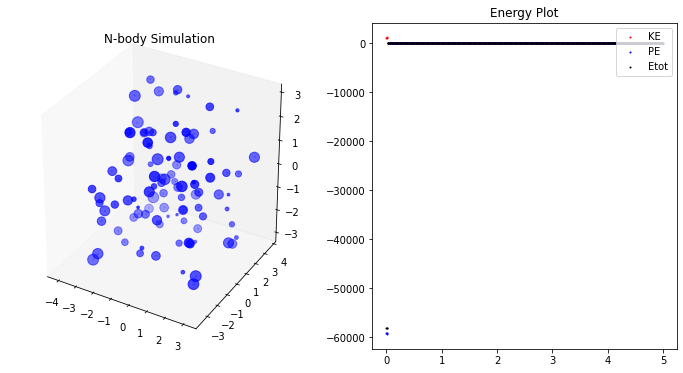

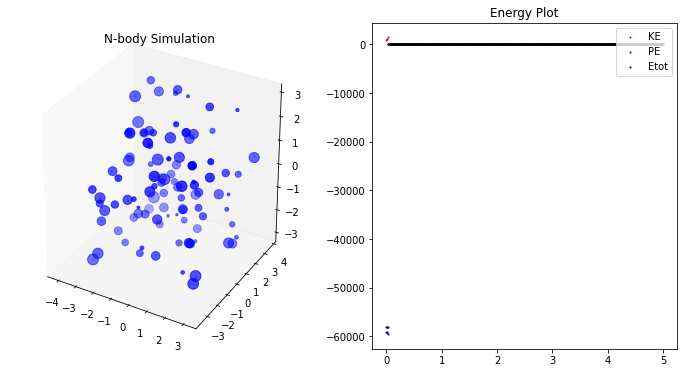

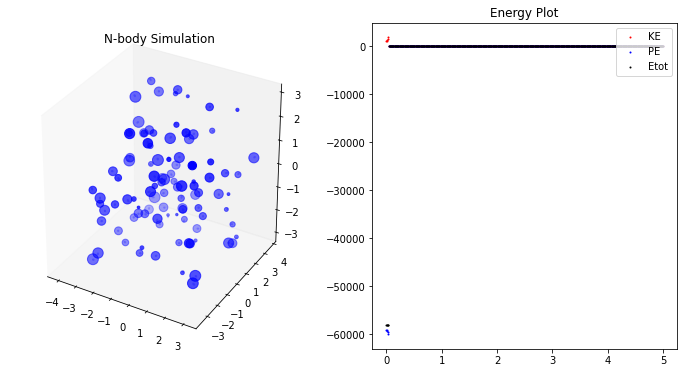

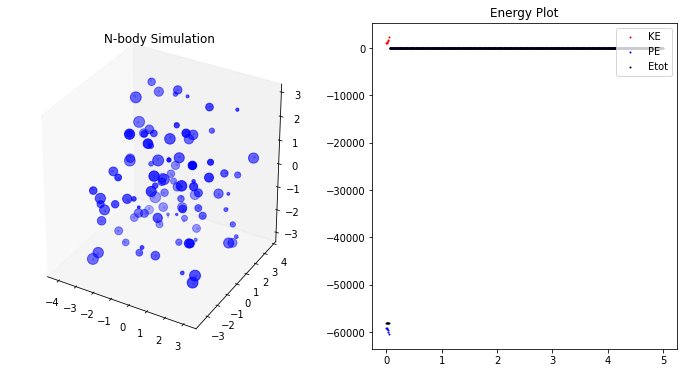

...

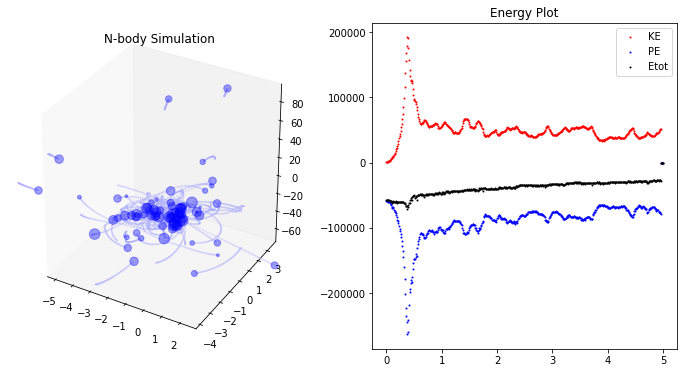

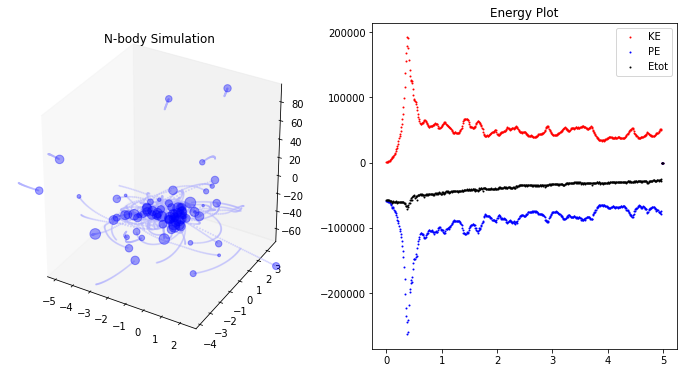

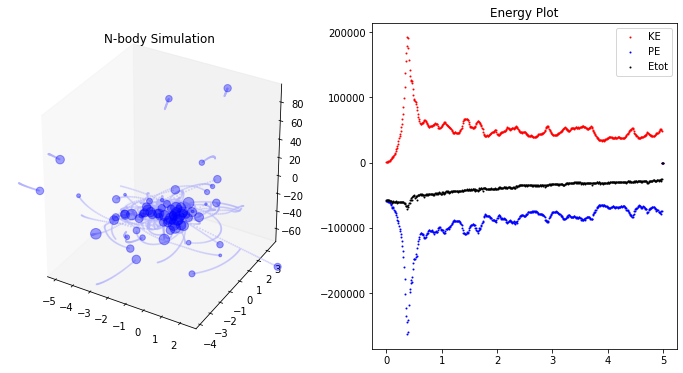

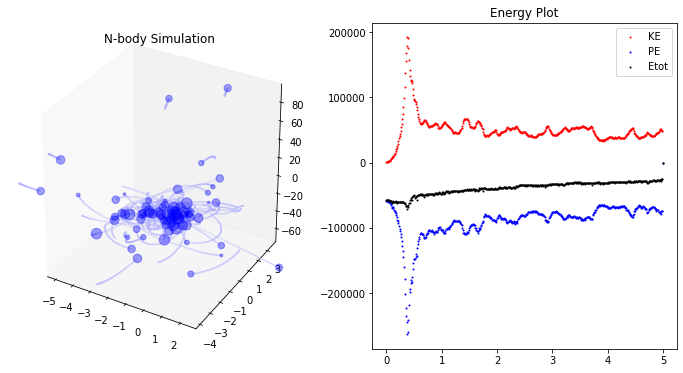

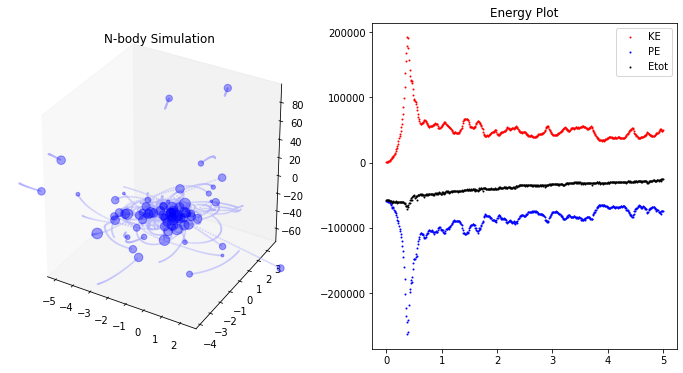

In [11]:
# Simulation Main Loop
filenames = []
for i in range(Nt):
  # (1/2) kick
  velocity += acc * dt/2.0
  
  # drift
  position += velocity * dt
  
  # update accelerations
  acc = acceleration( position, mass, G, delta )
  
  # (1/2) kick
  velocity += acc * dt/2.0
  
  # update time
  t += dt
  
  # get energy of system
  KE, PE  = Energy( position, velocity, mass, G )
  
  # save energies, positions for plotting trail
  save_position[:,:,i+1] = position
  save_KineticE[i+1] = KE
  save_PotentialE[i+1] = PE
  center_of_mass = position.T @ mass/np.sum(mass)
  #print(center_of_mass, position[0])

  # plot in real time

  fig = plt.figure(figsize=(12,6))
  ax1 = fig.add_subplot(121, projection = '3d')
  #plt.subplot(1, 2, 1)
  ax1.set_title("N-body Simulation")
  xx = save_position[:,0,max(i-50,0):i+1]
  yy = save_position[:,1,max(i-50,0):i+1]
  zz = save_position[:,2,max(i-50,0):i+1]
  ax1.scatter(xx,yy,zz, s=1,color=[.7,.7,1])
  ax1.scatter3D(position[:,0],position[:,1],position[:,2], s=mass*10,color='blue')
  ax1.set_xlim(center_of_mass[0,0]-zoom, center_of_mass[0,0]+zoom)
  ax1.set_ylim(center_of_mass[1,0]-zoom, center_of_mass[1,0]+zoom)
  #ax1.view_init(0, -90)
  ax1.grid(False)
  #ax1.axis("off")


  ax2 = fig.add_subplot(122)
  
  ax2.set_title("Energy Plot")
  ax2.scatter(t_all,save_KineticE,color='red',s=1,label='KE')
  ax2.scatter(t_all,save_PotentialE,color='blue',s=1,label='PE')
  ax2.scatter(t_all,save_KineticE+save_PotentialE,color='black',s=1,label='Etot')
  plt.savefig('img_%d.png'%(i),bbox_inches='tight')
  filenames.append('img_%d.png'%(i))
  ax2.legend(loc='upper right')

  plt.show(fig)

In [12]:
import imageio
print('Creating gif\n')
with imageio.get_writer('mygif.gif', mode='I') as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)


Creating gif

